# Illusion Diffusion
By [Matt Tancik](https://www.matthewtancik.com/)

Based on fast.ai [diffusion notebooks](https://github.com/fastai/diffusion-nbs).

![ChessUrl](https://user-images.githubusercontent.com/3310961/218217058-4c3daad4-1e3f-4f14-8c50-782d40c70501.gif "chess")



In [ ]:
# @title #Install requirements
!pip install -q --upgrade transformers diffusers ftfy mediapy

from base64 import b64encode

import torch
from diffusers import AutoencoderKL, LMSDiscreteScheduler, UNet2DConditionModel
from huggingface_hub import notebook_login

import numpy as np
import mediapy as mp
import cv2

from pathlib import Path
from torch import autocast
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer, logging

torch.manual_seed(1)
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

# Supress some unnecessary warnings when loading the CLIPTextModel
logging.set_verbosity_error()

# Set device
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.1/40.1 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 127.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 85.3 MB/s eta 0:00:00


In [ ]:
# @title #Load Models
# Load the autoencoder model which will be used to decode the latents into image space.
vae = AutoencoderKL.from_pretrained("runwayml/stable-diffusion-v1-5", subfolder="vae", torch_dtype=torch.float16)

# Load the tokenizer and text encoder to tokenize and encode the text.
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14")

# The UNet model for generating the latents.
unet = UNet2DConditionModel.from_pretrained("runwayml/stable-diffusion-v1-5", subfolder="unet", torch_dtype=torch.float16)

# The noise scheduler
scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000)

# To the GPU we go!
vae = vae.to(torch_device)
text_encoder = text_encoder.to(torch_device)
unet = unet.to(torch_device)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/905 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

**rotation:90, first prompt: a dog, second prompt: a cat**

0


/tmp/ipython-input-3389586531.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

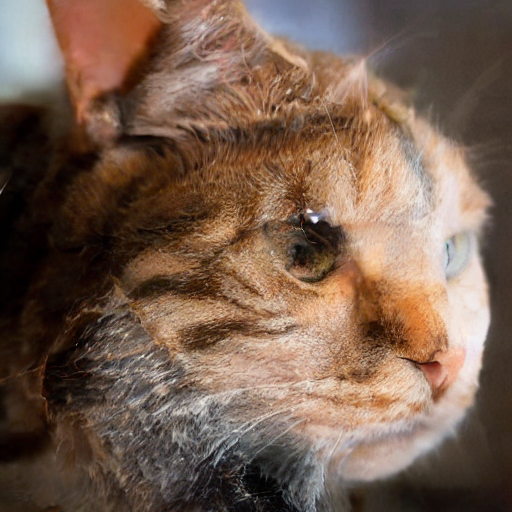
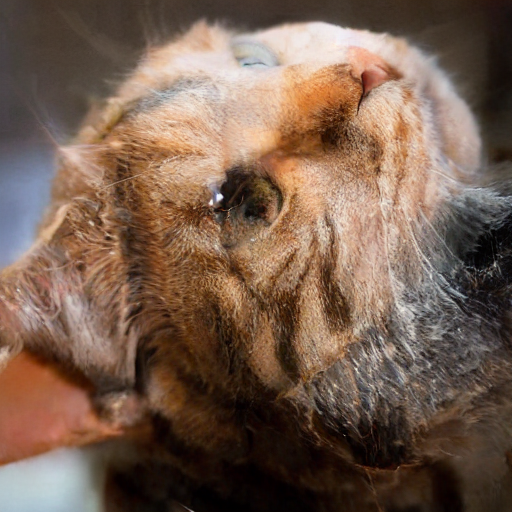

In [ ]:
#@title #Generate Images
first_prompt = "A dog" #@param {type:"string"}
second_prompt = "A cat" #@param {type:"string"}
rotation_deg = 90 #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:90, first prompt: a cat, second prompt: a dog**

0


/tmp/ipython-input-3433465571.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

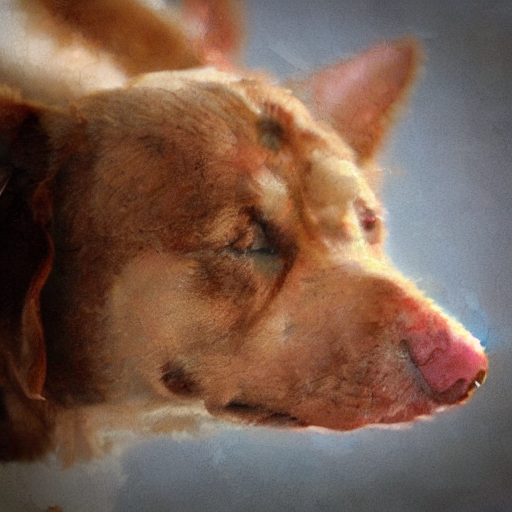
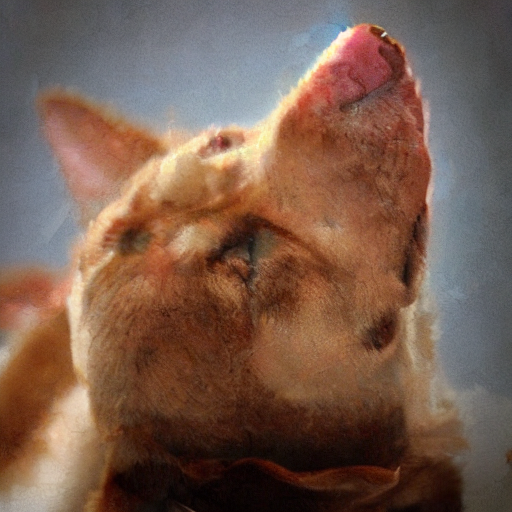

In [ ]:
#@title #Generate Images
first_prompt = "A cat" #@param {type:"string"}
second_prompt = "A dog" #@param {type:"string"}
rotation_deg = 90 #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:180, first prompt: a dog, second prompt: a cat**

0


/tmp/ipython-input-1271448629.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

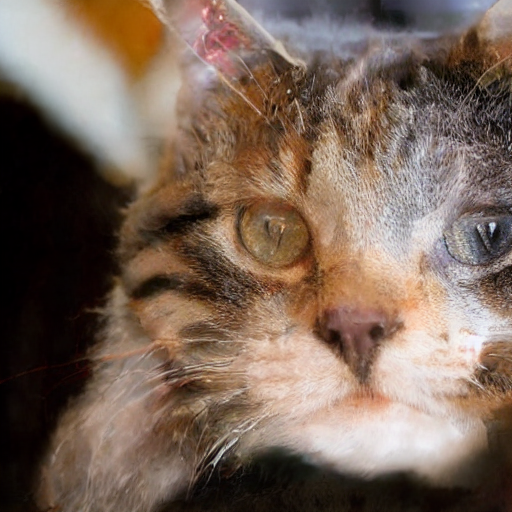
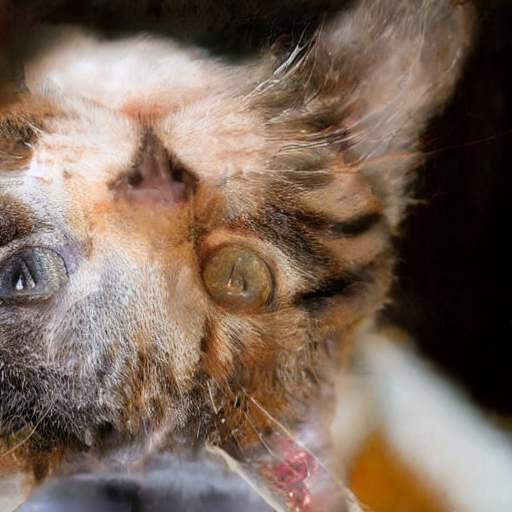

In [ ]:
#@title #Generate Images
first_prompt = "A dog" #@param {type:"string"}
second_prompt = "A cat" #@param {type:"string"}
rotation_deg = "180" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:180, first prompt: a cat, second prompt: a dog**

0


/tmp/ipython-input-789229710.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

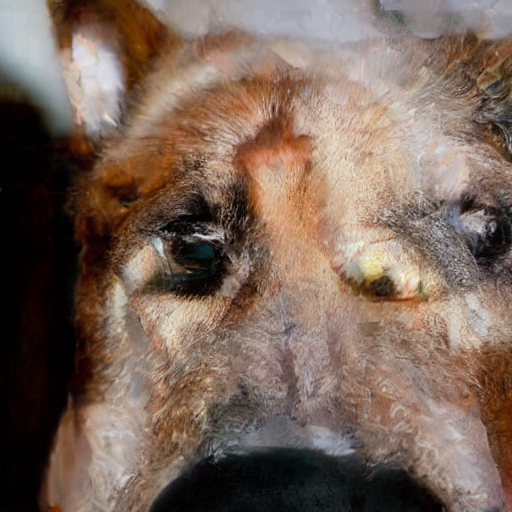
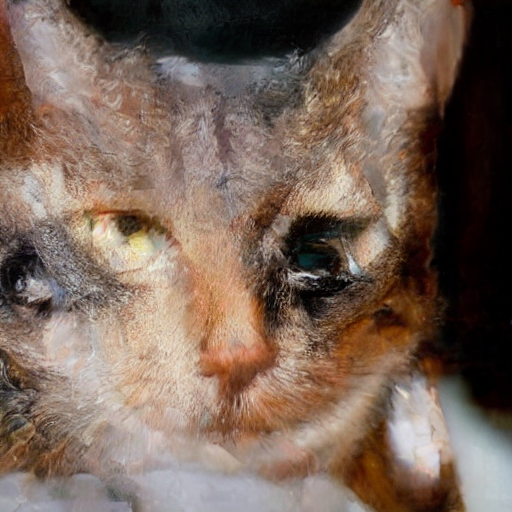

In [ ]:
#@title #Generate Images
first_prompt = "A cat" #@param {type:"string"}
second_prompt = "A dog" #@param {type:"string"}
rotation_deg = "180" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:90, first prompt: a duck, second prompt: a rabbit**

0


/tmp/ipython-input-1227666252.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

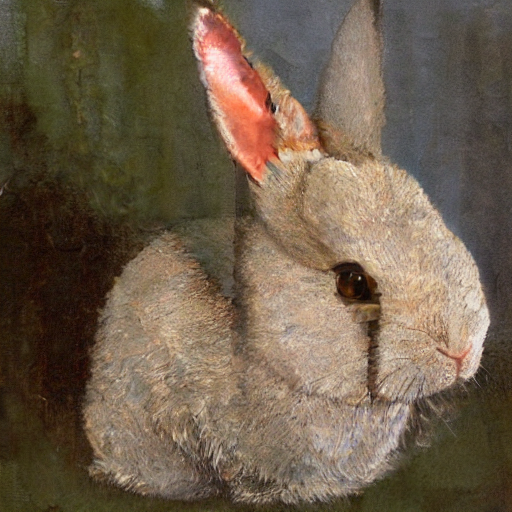
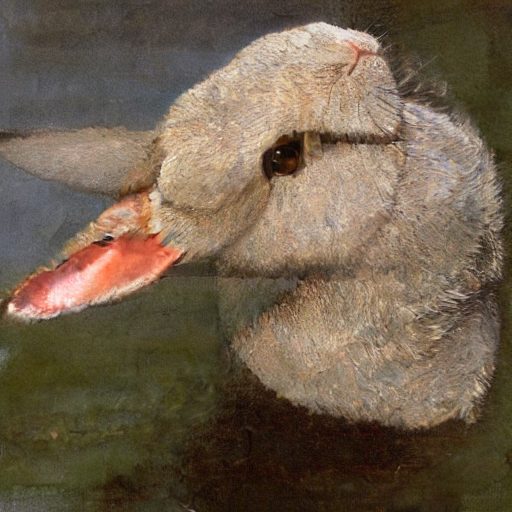

In [ ]:
#@title #Generate Images
first_prompt = "A duck" #@param {type:"string"}
second_prompt = "A rabbit" #@param {type:"string"}
rotation_deg = "90" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:90, first prompt: a rabbit, second prompt: a duck**

0


/tmp/ipython-input-2269407859.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

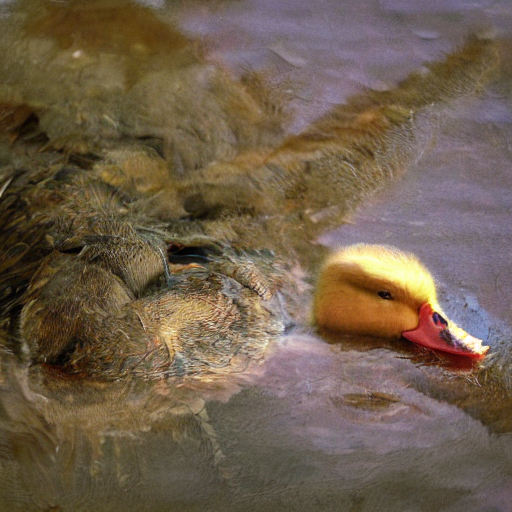
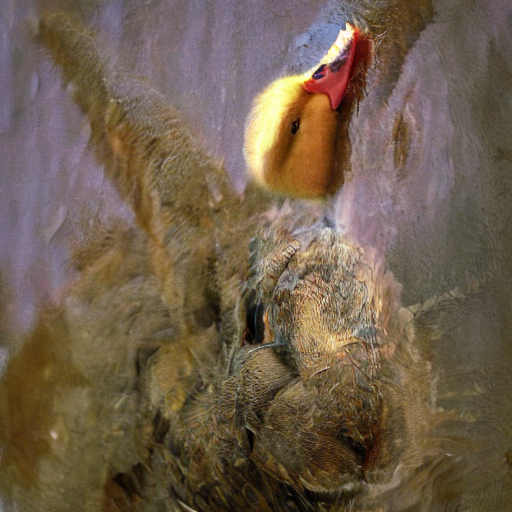

In [ ]:
#@title #Generate Images
first_prompt = "A rabbit" #@param {type:"string"}
second_prompt = "A duck" #@param {type:"string"}
rotation_deg = "90" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:180, first prompt: a duck, second prompt: a rabbit**

0


/tmp/ipython-input-2697712216.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

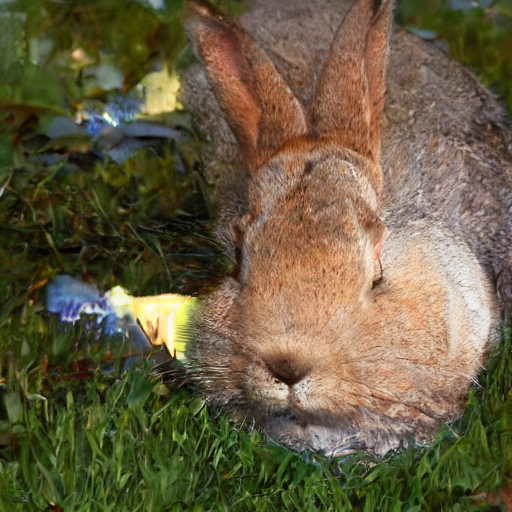
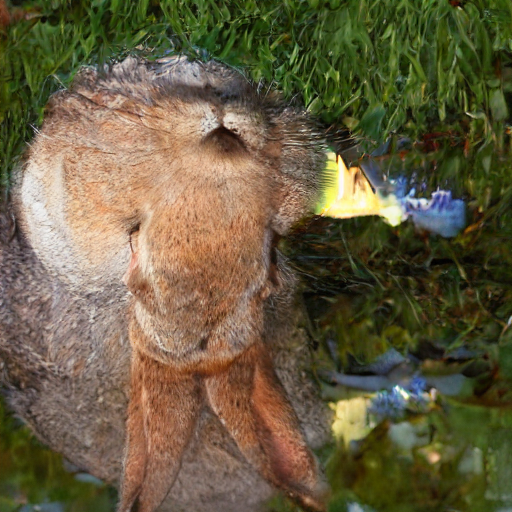

In [ ]:
#@title #Generate Images
first_prompt = "A duck" #@param {type:"string"}
second_prompt = "A rabbit" #@param {type:"string"}
rotation_deg = "180" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

**rotation:180, first prompt: a rabbit, second prompt: a duck**

0


/tmp/ipython-input-2948038678.py:42: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

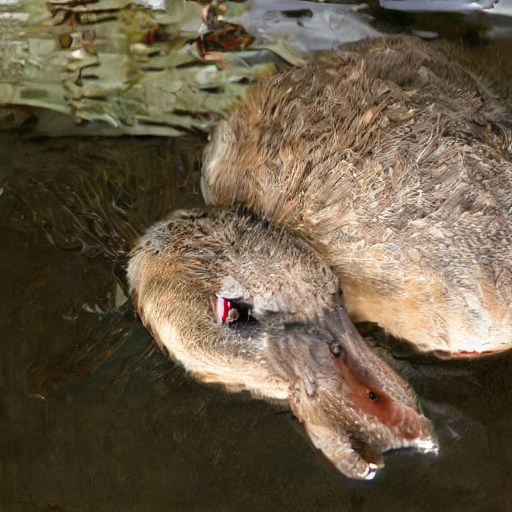
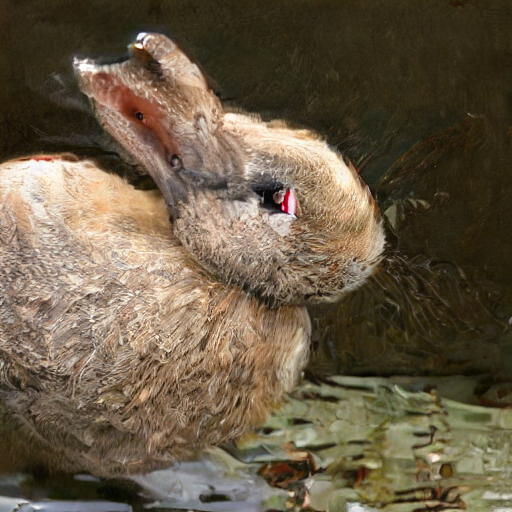

In [ ]:
#@title #Generate Images
first_prompt = "A rabbit" #@param {type:"string"}
second_prompt = "A duck" #@param {type:"string"}
rotation_deg = "180" #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42 #@param {type:"integer"}
generator = torch.manual_seed(seed)
batch_size = 1
rotate = int(rotation_deg) // 90

# for seed in [0,1,2,3 ,4,5,6,7]:
# 0,3,5
for seed in [0]:
    print(seed)
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer(
        [""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt"
    )
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
    (batch_size, unet.in_channels, height // 8, width // 8),
    generator=generator,
    )
    latents = latents.half()
    latents = latents.to(torch_device)
    latents = latents * scheduler.init_noise_sigma # Scaling (previous versions did latents = latents * self.scheduler.sigmas[0]

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            # expand the latents if we are doing classifier-free guidance to avoid doing two forward passes.


            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            # Scale the latents (preconditioning):
            # latent_model_input = latent_model_input / ((sigma**2 + 1) ** 0.5) # Diffusers 0.3 and below
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            # predict the noise residual
            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            # perform guidance
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            # compute the previous noisy sample x_t -> x_t-1
            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])

In [ ]:
# @title #Generate Animation
num_frames = 300 # @param

degrees = 90 * rotate

def rotate_image(image, angle):
    rows, cols, _ = image.shape
    rot_mat = cv2.getRotationMatrix2D((cols/2,rows/2), angle, 1)
    result = cv2.warpAffine(image, rot_mat, (cols,rows))
    return result

def easeInOutQuint(x):
    if x < 0.5:
        return 4 * x**3
    else:
        return 1 - (-2 * x + 2)**3 / 2

ts = np.concatenate([np.zeros(num_frames//4),
                     np.linspace(0, 1, num_frames//4),
                     np.ones(num_frames//4),
                     np.linspace(1, 0, num_frames//4)])
ts = [easeInOutQuint(x) for x in ts]

frames = [rotate_image(image, t * degrees) for t in ts]
mp.show_video(frames)

Hyperparameters testing on 90-degree rotation illusion

first prompt: a duck, second prompt: a rabbit

**1. Different seeds** (seed_list = [0, 1, 2, 42, 100])

Running with seed = 0


/tmp/ipython-input-1540811399.py:43: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

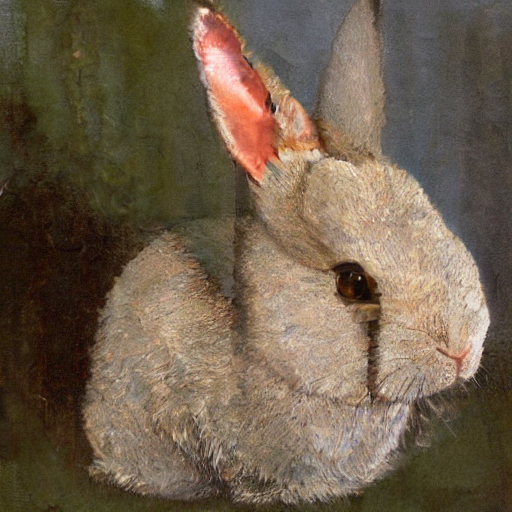
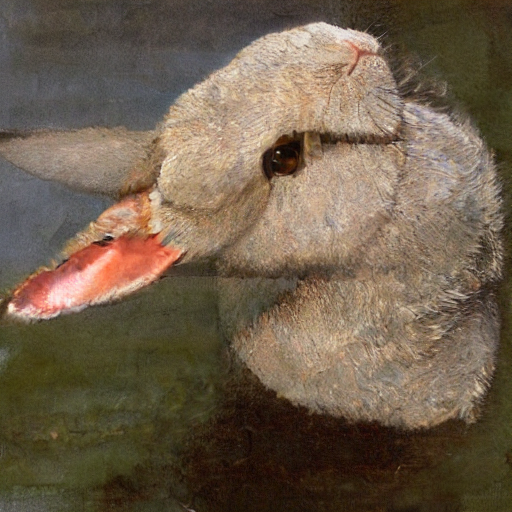

Image saved as generated_seed_0.png
Running with seed = 1


0it [00:00, ?it/s]

,

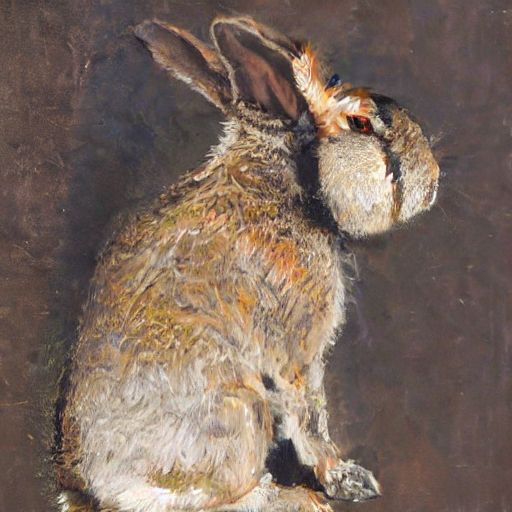
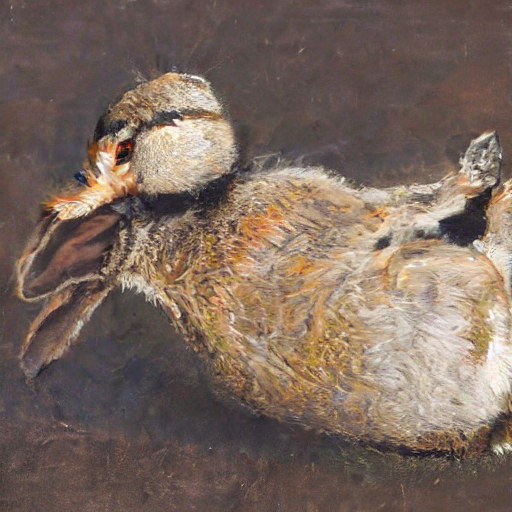

Image saved as generated_seed_1.png
Running with seed = 2


0it [00:00, ?it/s]

,

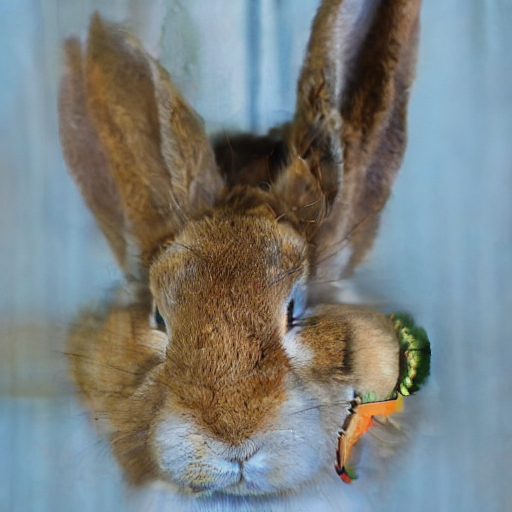
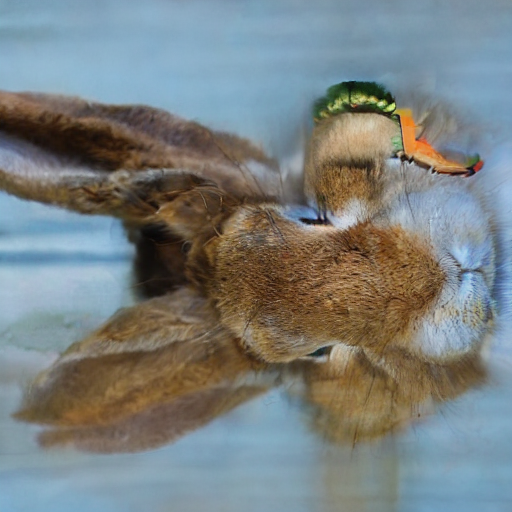

Image saved as generated_seed_2.png
Running with seed = 42


0it [00:00, ?it/s]

,

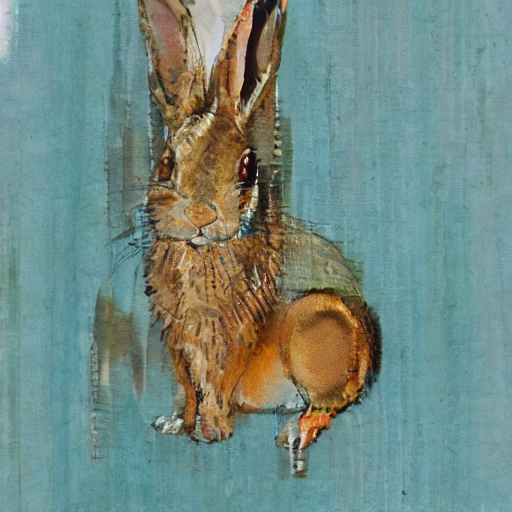
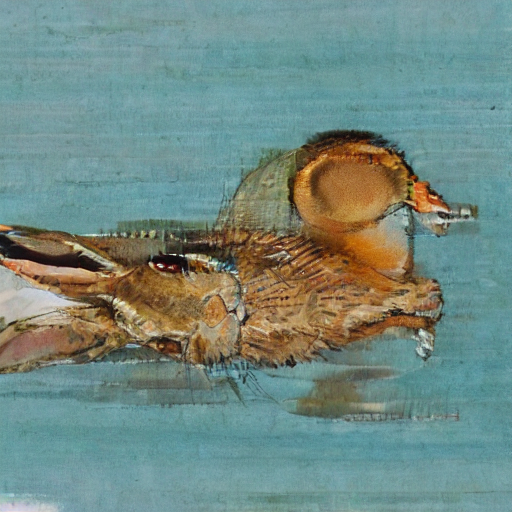

Image saved as generated_seed_42.png
Running with seed = 100


0it [00:00, ?it/s]

,

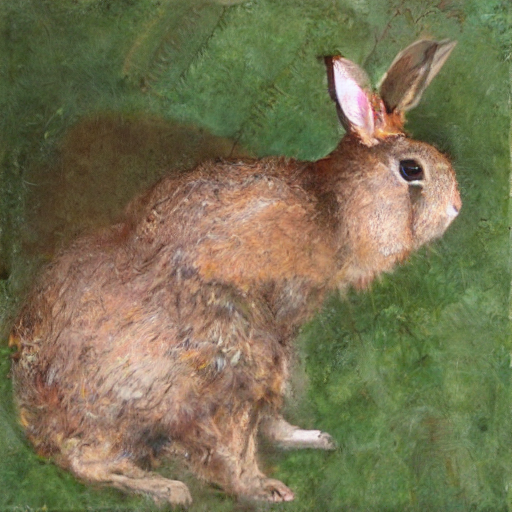
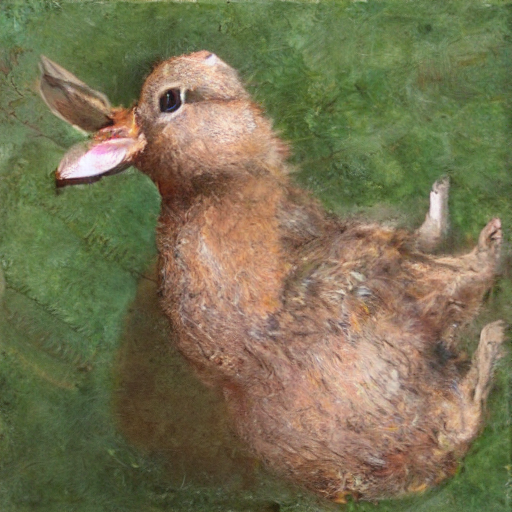

Image saved as generated_seed_100.png


In [ ]:
# seed tests
#@title #Generate Images

from PIL import Image

first_prompt = "A duck" #@param {type:"string"}
second_prompt = "A rabbit" #@param {type:"string"}
rotation_deg = 90 #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
#@markdown More steps improves quality but takes longer.
num_inference_steps = 500 #@param {type:"integer"}
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
batch_size = 1
rotate = int(rotation_deg) // 90

# test 5 different seeds
seed_list = [0, 1, 2, 42, 100]

for seed in seed_list:
    print(f"Running with seed = {seed}")
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer([""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt")
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
        (batch_size, unet.in_channels, height // 8, width // 8),
        generator=generator,
    ).half().to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            sigma = scheduler.sigmas[i]
            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_2).sample

            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    # Display
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]

    mp.show_images([image, np.rot90(image, rotate, (0, 1))])
    Image.fromarray(image).save(f"generated_seed_{seed}.png")
    print(f"Image saved as generated_seed_{seed}.png")


**2. Different Inference Steps**  steps_list = [50, 100, 200, 500, 1000]


Running with num_inference_steps = 50, seed = 42


/tmp/ipython-input-383584643.py:45: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

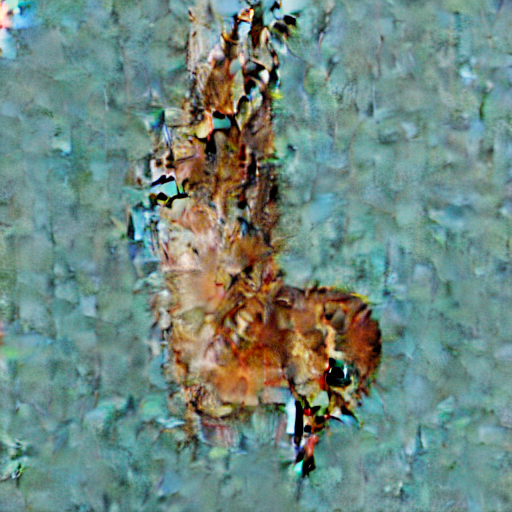
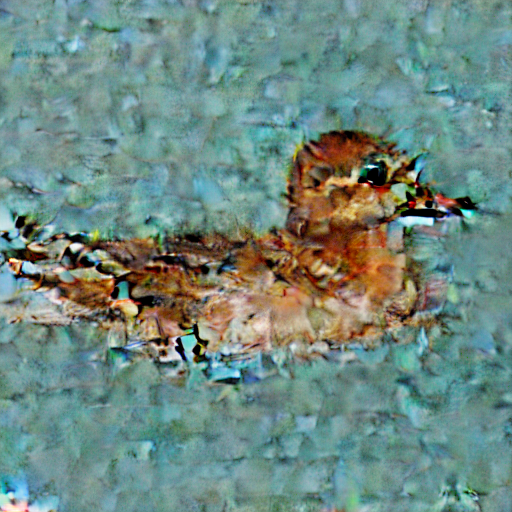

Saved as generated_steps_50.png | Time: 7.68 sec

Running with num_inference_steps = 100, seed = 42


0it [00:00, ?it/s]

,

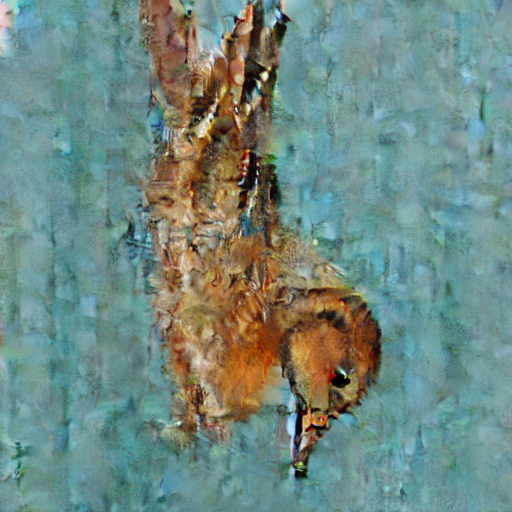
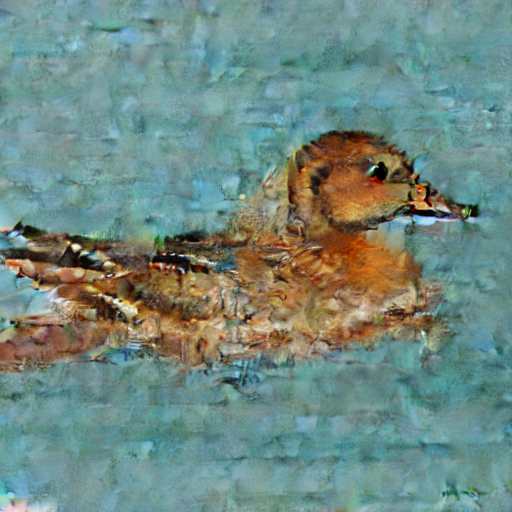

Saved as generated_steps_100.png | Time: 14.81 sec

Running with num_inference_steps = 200, seed = 42


0it [00:00, ?it/s]

,

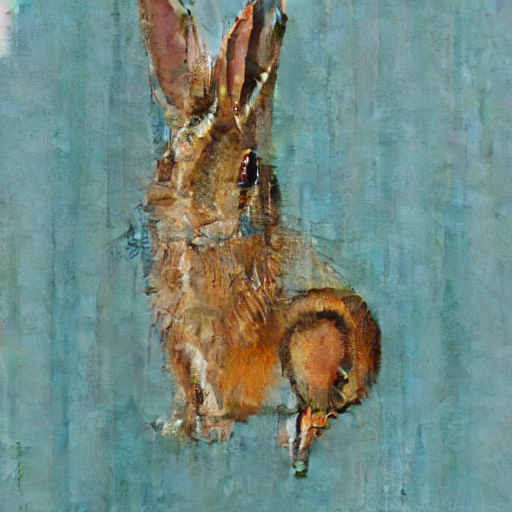
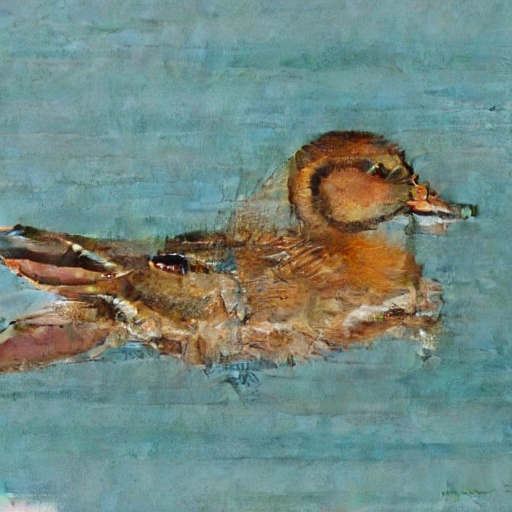

Saved as generated_steps_200.png | Time: 29.55 sec

Running with num_inference_steps = 500, seed = 42


0it [00:00, ?it/s]

,

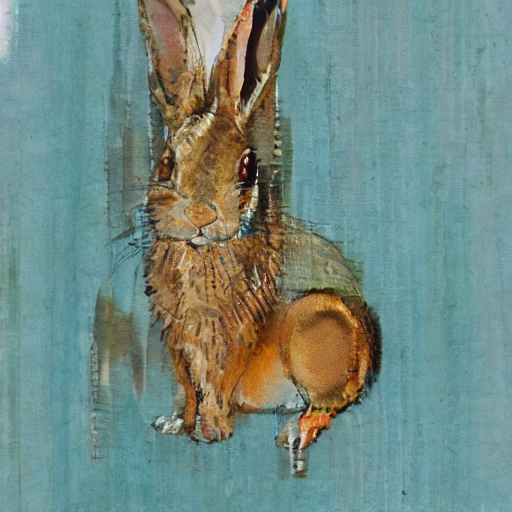
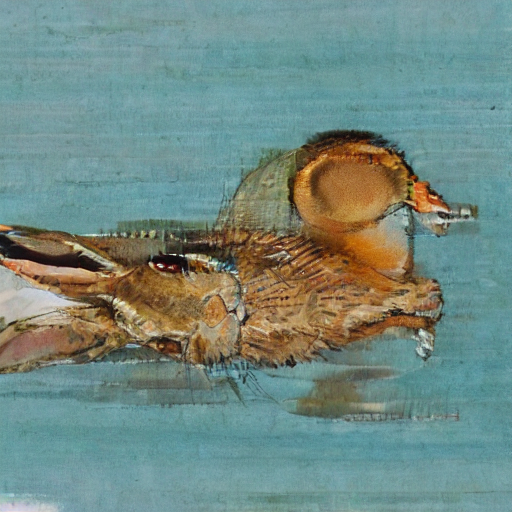

Saved as generated_steps_500.png | Time: 75.12 sec

Running with num_inference_steps = 1000, seed = 42


0it [00:00, ?it/s]

,

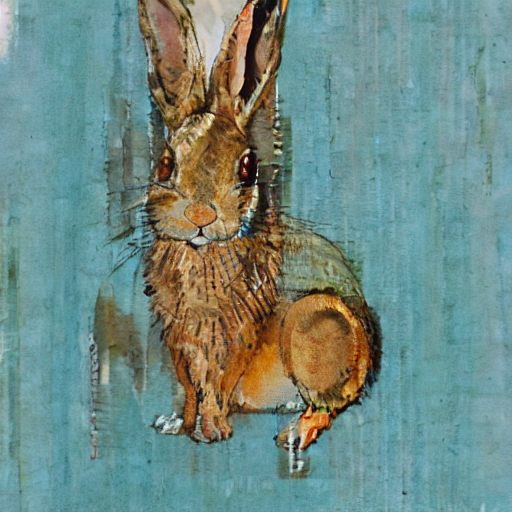
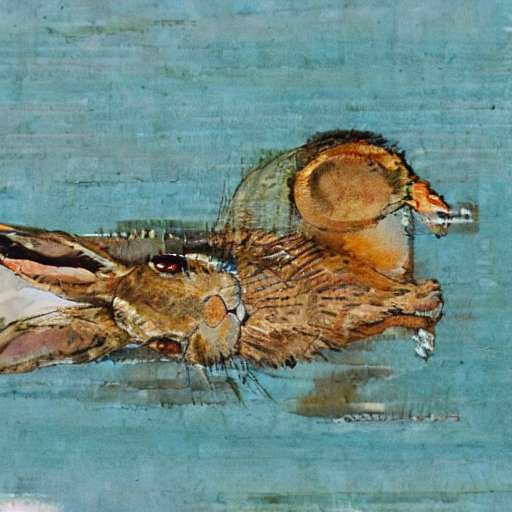

Saved as generated_steps_1000.png | Time: 153.01 sec


In [ ]:
# num_inference_steps:from PIL import Image
import time

#@title #Generate Images
first_prompt = "A duck" #@param {type:"string"}
second_prompt = "A rabbit" #@param {type:"string"}
rotation_deg = 90 #@param [90, 180]
height = 512                        # default height of Stable Diffusion
width = 512                         # default width of Stable Diffusion
guidance_scale = 7.5 #@param {type:"slider", min:2, max:15, step:0.5}
seed = 42
batch_size = 1
rotate = int(rotation_deg) // 90

# test num_inference_steps list
steps_list = [50, 100, 200, 500, 1000]

for steps in steps_list:
    print(f"\nRunning with num_inference_steps = {steps}, seed = {seed}")
    start_time = time.time()
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length",
                           max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length",
                             max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer([""] * batch_size, padding="max_length",
                             max_length=max_length, return_tensors="pt")
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(steps)

    # Prep latents
    latents = torch.randn(
        (batch_size, unet.in_channels, height // 8, width // 8),
        generator=generator,
    ).half().to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t,
                                      encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t,
                                      encoder_hidden_states=text_embeddings_2).sample

            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]


    mp.show_images([image, np.rot90(image, rotate, (0, 1))])
    Image.fromarray(image).save(f"generated_steps_{steps}.png")

    elapsed = time.time() - start_time
    print(f"Saved as generated_steps_{steps}.png | Time: {elapsed:.2f} sec")


**3. Different Guidance Scale** guidance_list = [2.0, 5.0, 7.5, 10.0, 15.0]


Running with guidance_scale = 2.0, steps = 500, seed = 42


/tmp/ipython-input-883628443.py:46: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (batch_size, unet.in_channels, height // 8, width // 8),


0it [00:00, ?it/s]

,

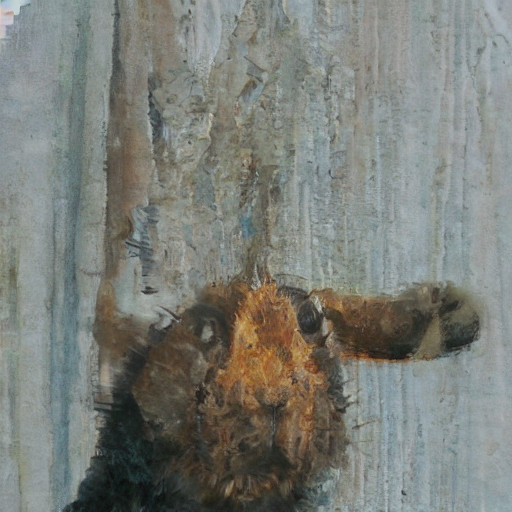
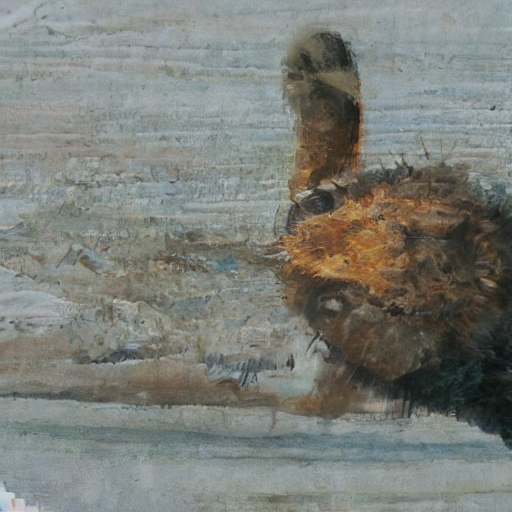

Saved as generated_guidance_2.0.png | Time: 74.41 sec

Running with guidance_scale = 5.0, steps = 500, seed = 42


0it [00:00, ?it/s]

,

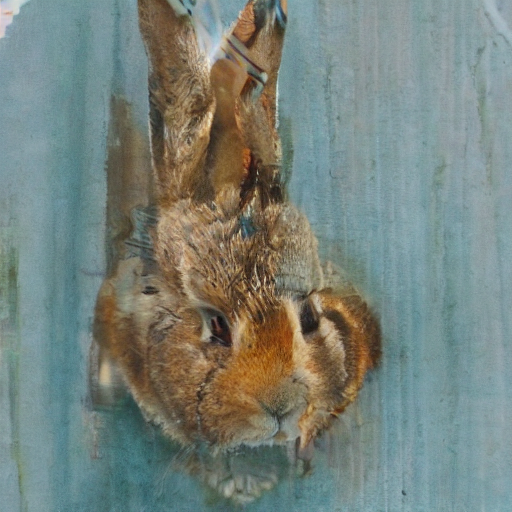
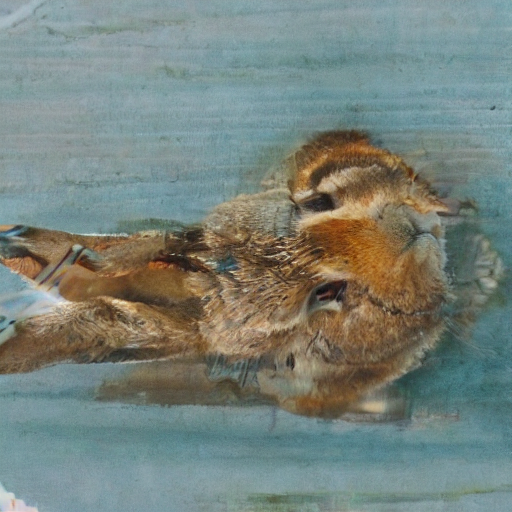

Saved as generated_guidance_5.0.png | Time: 75.82 sec

Running with guidance_scale = 7.5, steps = 500, seed = 42


0it [00:00, ?it/s]

,

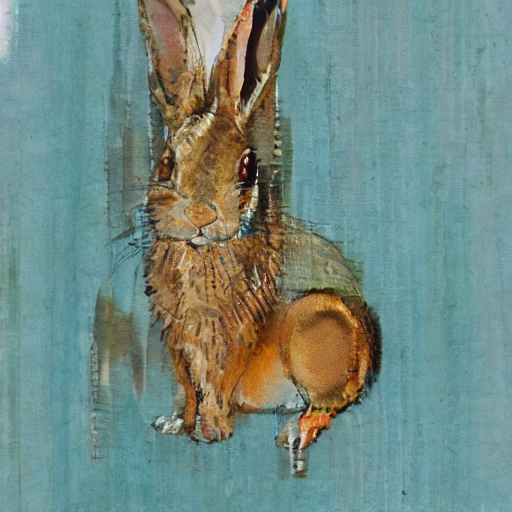
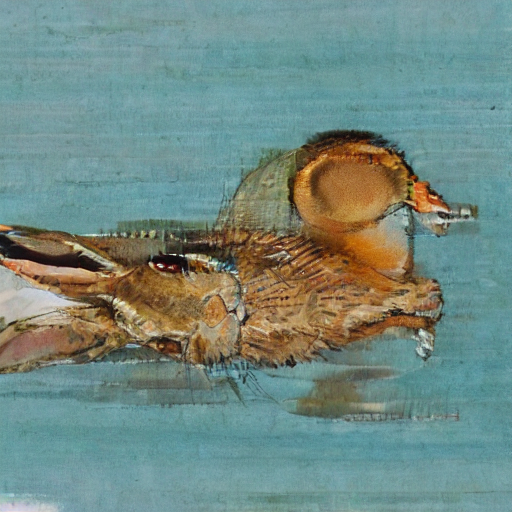

Saved as generated_guidance_7.5.png | Time: 76.92 sec

Running with guidance_scale = 10.0, steps = 500, seed = 42


0it [00:00, ?it/s]

,

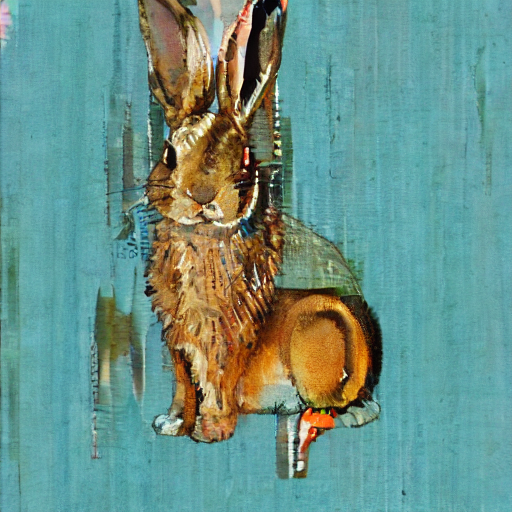
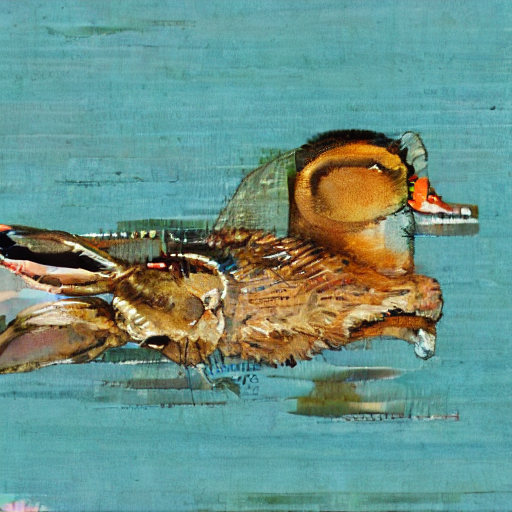

Saved as generated_guidance_10.0.png | Time: 77.17 sec

Running with guidance_scale = 15.0, steps = 500, seed = 42


0it [00:00, ?it/s]

,

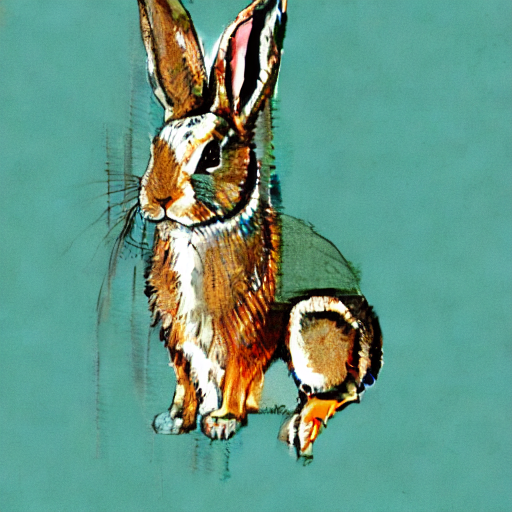
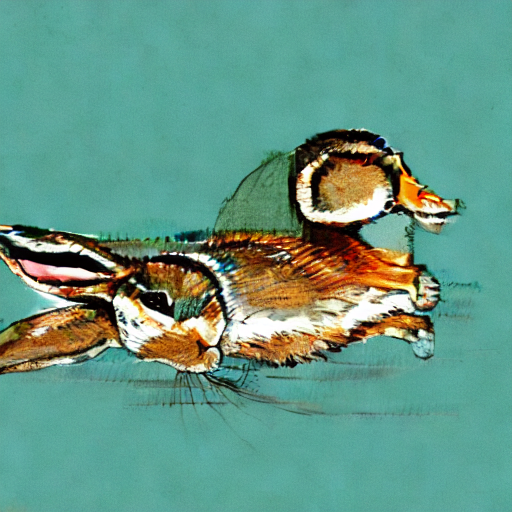

Saved as generated_guidance_15.0.png | Time: 76.82 sec


In [ ]:
#test guidance_scale:
from PIL import Image
import time

#@title #Generate Images
first_prompt = "A duck" #@param {type:"string"}
second_prompt = "A rabbit" #@param {type:"string"}
rotation_deg = 90 #@param [90, 180]
height = 512
width = 512
seed = 42
batch_size = 1
rotate = int(rotation_deg) // 90

# test guidance_scale list
num_inference_steps = 500
guidance_list = [2.0, 5.0, 7.5, 10.0, 15.0]

for guidance_scale in guidance_list:
    print(f"\nRunning with guidance_scale = {guidance_scale}, steps = {num_inference_steps}, seed = {seed}")
    start_time = time.time()
    generator = torch.manual_seed(seed)

    # Prep text
    text_input = tokenizer([first_prompt], padding="max_length",
                           max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")
    text_input_2 = tokenizer([second_prompt], padding="max_length",
                             max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

    with torch.no_grad():
        text_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
        test_embeddings_2 = text_encoder(text_input_2.input_ids.to(torch_device))[0]
    max_length = text_input.input_ids.shape[-1]
    uncond_input = tokenizer([""] * batch_size, padding="max_length",
                             max_length=max_length, return_tensors="pt")
    with torch.no_grad():
        uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
    text_embeddings = torch.cat([uncond_embeddings, text_embeddings])
    text_embeddings_2 = torch.cat([uncond_embeddings, test_embeddings_2])

    # Prep Scheduler
    scheduler.set_timesteps(num_inference_steps)

    # Prep latents
    latents = torch.randn(
        (batch_size, unet.in_channels, height // 8, width // 8),
        generator=generator,
    ).half().to(torch_device)
    latents = latents * scheduler.init_noise_sigma

    # Loop
    with autocast("cuda"):
        for i, t in tqdm(enumerate(scheduler.timesteps)):
            if i % 2 == 0:
                latents = torch.rot90(latents, rotate, [2, 3])
                latent_model_input = torch.cat([latents] * 2)
            else:
                latent_model_input = torch.cat([latents] * 2)

            latent_model_input = scheduler.scale_model_input(latent_model_input, t)

            with torch.no_grad():
                if i % 2 == 0:
                    noise_pred = unet(latent_model_input, t,
                                      encoder_hidden_states=text_embeddings).sample
                else:
                    noise_pred = unet(latent_model_input, t,
                                      encoder_hidden_states=text_embeddings_2).sample

            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            if i % 2 == 0:
                noise_pred = torch.rot90(noise_pred, -rotate, [2, 3])
                latents = torch.rot90(latents, -rotate, [2, 3])

            latents = scheduler.step(noise_pred, t, latents).prev_sample

    # scale and decode the image latents with vae
    latents = 1 / 0.18215 * latents
    with torch.no_grad():
        image = vae.decode(latents).sample

    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.detach().cpu().permute(0, 2, 3, 1).numpy()
    image = (image * 255).round().astype("uint8")[0, ...]


    mp.show_images([image, np.rot90(image, rotate, (0, 1))])
    Image.fromarray(image).save(f"generated_guidance_{guidance_scale}.png")

    elapsed = time.time() - start_time
    print(f"Saved as generated_guidance_{guidance_scale}.png | Time: {elapsed:.2f} sec")
